In [1]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 
import pyfits
import scipy
from scipy import signal

from starlettoolbox import starlet_transform, reconstruct_image

In [2]:
# Define utility functions
def l1_norm(x):
    return np.sum(np.abs(x))
def l2_norm(x):
    return np.sum(np.hstack(x)**2)

# Multiresolution mask estimation

In this part we will try to find in each wavelet scale which are the coefficients that are related to noise and the ones that are related to the signal.

For this, we start from a noise-less image of the sky and add some noise with a given variance sigma.

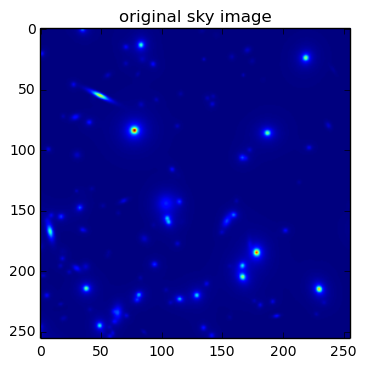

In [3]:
initial_im = pyfits.open('simu_sky.fits')[0].data
plt.imshow(initial_im)
plt.title('original sky image')
plt.show()

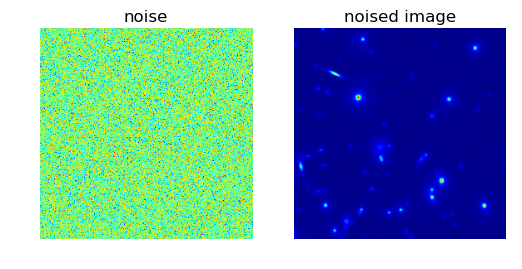

In [4]:
noise_level = 50
noise = np.random.normal(0, 1, [256, 256])

noised_image = noise_level*noise + initial_im
fig = plt.figure()
ax1 = fig.add_subplot(121)
ax1.imshow(noise)
ax1.set_title('noise')
ax1.axis('off') 
ax2 = fig.add_subplot(122)
ax2.imshow(noised_image)
ax2.axis('off')
ax2.set_title('noised image')
plt.show()

To estimate the standard deviation in the original image, the noised image and the wavelet space we use the robust medium average deviation estimator.

We then compute the standard deviation in the noised image and its representation in the wavelet space as well as the blanck noise's coefficients in the wavelet space.  

In [59]:
def mad(z):
    normal_factor = 1/0.6735
    return np.median(abs(z - np.median(z)))*normal_factor

def compute_mad_at_scales(starlet_coeffs, starlet_fin):
    starlet_nb = starlet_coeffs.shape[0]
    mad_res = []
    for idx in range(starlet_nb):
        mad_res.append(mad(starlet_coeffs[idx, :, :]))
    mad_res.append(mad(starlet_fin))
    return mad_res

def mad_from_image_at_scale(image, starlet_nb=5):
    mad_res = []
    starlet_fin, starlet_coeff = starlet.Starlet_Forward2D(image, J=starlet_nb)
    starlet_coeff = np.array(starlet_coeff)
    print(starlet_coeff.shape)
    print(starlet_nb)
    for idx in range(starlet_nb):
        mad_res.append(mad(starlet_coeff[:, :, idx]))
    return mad_res

In [60]:
[starlet_coeffs_noised, fin_noised, mean_wav_noised] = starlet_transform(noised_image, 5)
[starlet_coeffs_noise, fin_noise, mean_wav_noise] = starlet_transform(noise, 5)

As we have a gaussian additive noise n that follows a centered normal law of standard deviation sigma, we have the following relationship between the noised image x and it's noiseless counterpart b:

x = b + sigma*n 

Computing the coefficient of the blank noise allows us to compute a multiplying factor of the noise level in the noised image with the following relationship :

lambda_i = k\*sigma\*sigma_i

Where lambda_i is the noise std in the noised image's wavelet space, k is a factor that allows us to tune our tolerance to noise (increasing noise decreases the level a signal has to reach to be considered as significant) and sigma_i is the std of blank noise in the corresponding wavelet scale.

A typical value for k is 3, and it is the one we choose for this numerical experimentation.

We can therefore estimate the level of the noise in the wavelet space, which we present in the following plot.


(5, 256, 256)


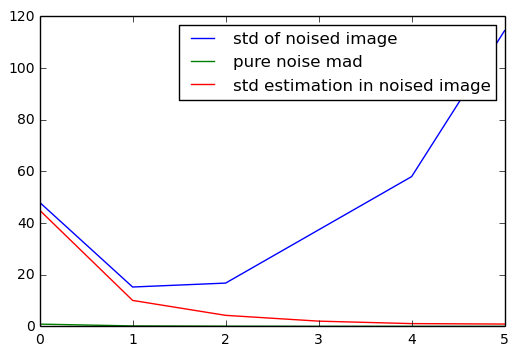

In [61]:
print(starlet_coeffs_noised.shape)

k = 3
mad_noised = compute_mad_at_scales(starlet_coeffs_noised, fin_noised)
mad_noise = compute_mad_at_scales(starlet_coeffs_noise, fin_noise)
estimated_stds = [50*noise_level for noise_level in mad_noise]
lambdas = [k*level for level in estimated_stds]
plt.plot(mad_noised, label='std of noised image')
plt.plot(mad_noise,label='pure noise mad')
plt.plot(estimated_stds, label='std estimation in noised image')
plt.legend()
plt.show()
image_std = mad(initial_im)


We can also estimate sigma, which is usefull in practice as the standard deviation of noise is usually unknown. 

In this case we use the relationship

mad(noised_image) at the first wavelet scale = sigma_1 * sigma

In [62]:
print('Estimated noise level in noised image : {mad_estim}'.format(mad_estim = mad_noised[0]/mad_noise[0] ))
print('Real noise level in noised image : {real_mad}'.format(real_mad = noise_level ))

Estimated noise level in noised image : 53.367584693378625
Real noise level in noised image : 50


We notice that this estimate is coherent with the real value.

/usr/lib/python3/dist-packages/matplotlib/collections.py:549: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == 'face':


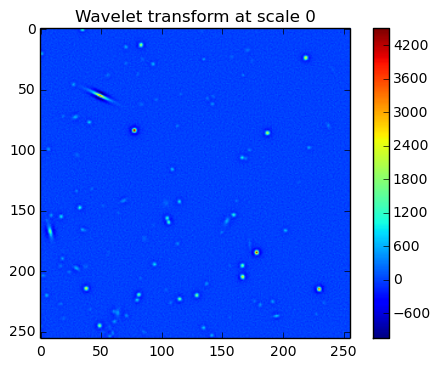

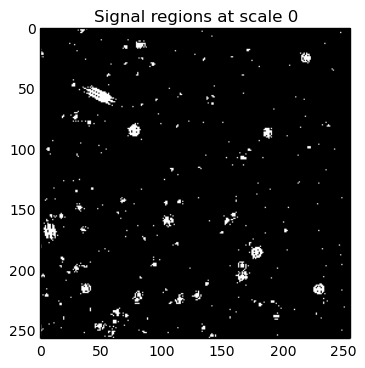

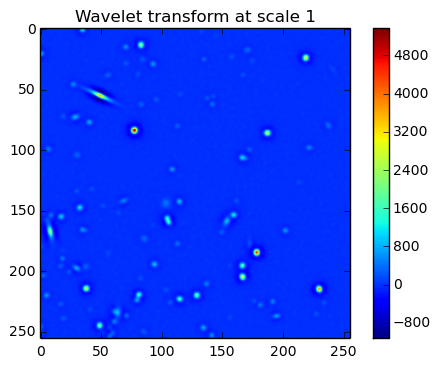

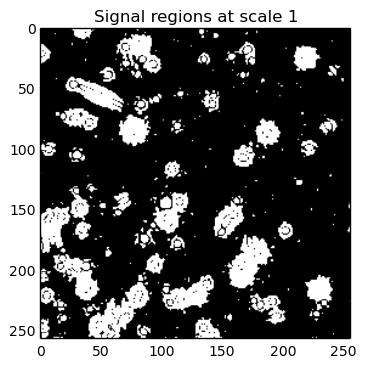

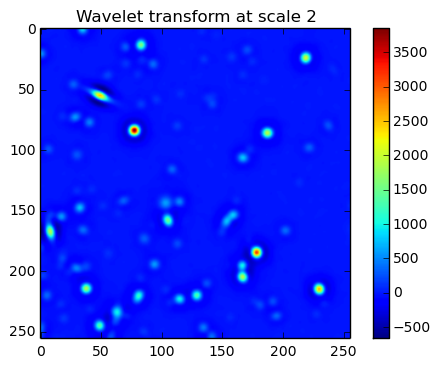

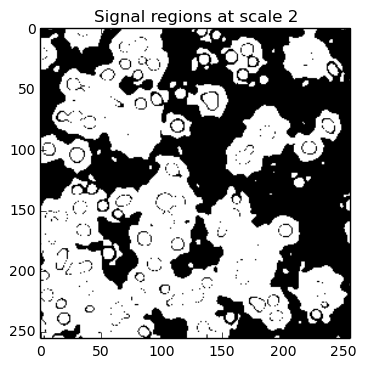

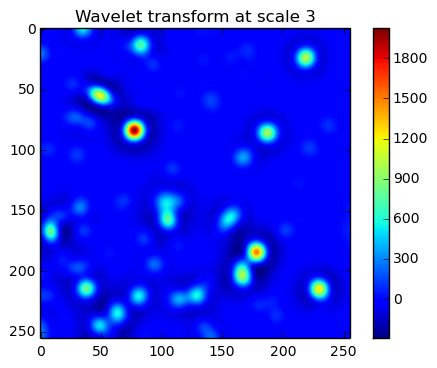

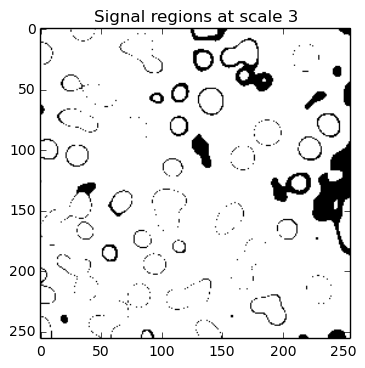

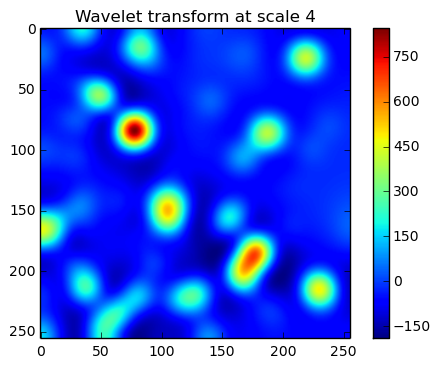

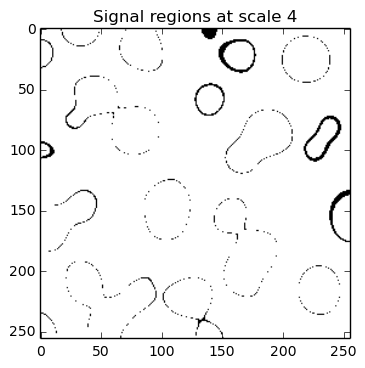

In [63]:
def multiresolution_mask(starlet_coeffs, noise_levels, plot_it=True):
    nb_scales = starlet_coeffs.shape[0]
    masks = np.copy(starlet_coeffs)
    for idx_scale in range(nb_scales):
        noise_level = noise_levels[idx_scale]
        starlet_coeff = starlet_coeffs[idx_scale,]
        mask = np.copy(starlet_coeff)
        mask[abs(starlet_coeff)<noise_level] = 0
        mask[abs(starlet_coeff)>=noise_level] = 1
        masks[idx_scale,] = mask
        if(plot_it):
            plt.imshow(starlet_coeff)
            plt.title('Wavelet transform at scale ' + str(idx_scale))
            plt.colorbar()
            plt.show()
            plt.imshow(mask, cmap='gray')
            plt.title('Signal regions at scale ' + str(idx_scale))
            plt.show()
    return masks
        
multires_masks = multiresolution_mask(starlet_coeffs_noised, lambdas)

We can visualy see that at the first scales, the region of interest are indeed preserved by the mask while the one that mainly correspond to 'background' are discarded.

As the wavelet scale increases, the relevant signal region increases and a smaller region is considered as having values that are driven by noise rather than by the original signal.

## Denoising with soft and hard thresholding

We will now apply soft and hard thresholdings to the coefficients in the wavelet scale to select the coefficients that we will use to reconstruct the original image. By removing the small coefficients in the wavelet scale we hope to remove the signal associated with the additive gaussian noise and therefore reconstruct the original image.

In [5]:
def soft_thresholding(value, threshold=1): 
    return np.sign(value)*np.maximum(abs(value) - threshold , np.zeros(np.shape(value)))

def hard_thresholding(value, threshold=1):
    return value*(abs(value)>threshold)

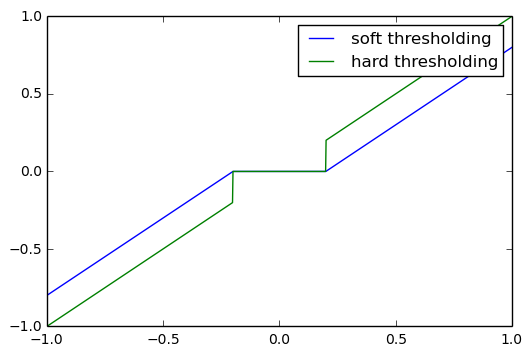

In [6]:
absc =  np.linspace(-1, 1, 1000)
st_res = soft_thresholding(np.asarray(absc), 0.2)
plt.plot(absc, st_res, label='soft thresholding')

ht_res = hard_thresholding(np.asarray(absc), 0.2)
plt.plot(absc, ht_res, label='hard thresholding')
plt.legend()
plt.show()

We observe that hard thresholding removes (squashes to zero) all the coefficients below a certain threshold and preserves the other. This threshold often produces artefacts and therefore we also explore soft thresholding. Soft thresholding allows us to avoid the discontinuity induced by the hard thresholding at the threshold value. But in order to avoid this discontinuity all the coefficients are reduced.

In [20]:
def reconstruct_image_thres(coeffs, final_image, thresholding_func=soft_thresholding, threshold=1 ):
    nb_wavelet = coeffs.shape[0]
    reconstructed_image = final_image
    coeff_count = 0
    for idx in range(nb_wavelet):
        additional_image = thresholding_func(coeffs[idx], threshold=threshold)
        reconstructed_image = reconstructed_image + additional_image
        coeff_count = coeff_count + np.sum(additional_image>0)
    return reconstructed_image, coeff_count

def multires_reconstruc(coeffs, final_image, noise_levels):
    nb_wavelet = coeffs.shape[0]
    reconstructed_image = final_image
    coeff_count = 0
    for idx in range(nb_wavelet):
        additional_image = hard_thresholding(coeffs[idx], threshold=noise_levels[idx])
        reconstructed_image = reconstructed_image + additional_image
        coeff_count = coeff_count + np.sum(additional_image>0)
    return reconstructed_image, coeff_count

def normalized_reconstruc_error(original, reconstructed):
    residual = np.sum((original - reconstructed)**2) 
    return residual/np.sum((original)**2)

def plot_reconstruct_results(original_image, reconstruct,
                             method_name, method_condition, threshold):
    # Compute residual image
    residual = reconstruct - noised_image
    # Plot the results
    fig = plt.figure()
    ax1 = fig.add_subplot(121)
    ax1.imshow(reconstruct)
    ax1.set_title('reconstructed image')
    ax1.axis('off') 
    ax2 = fig.add_subplot(122)
    ax2.imshow(residual)
    ax2.axis('off')
    ax2.set_title('residual image')
    fig.suptitle('Results for {method_name}, {thres}={threshold}'.format(method_name=method_name,
                                                                         threshold=threshold,
                                                                         thres=method_condition))
    plt.show()
    return normalized_reconstruc_error(original_image,reconstruct)

thresholds = [1, 5, 10, 15, 20, 30, 40]

## Hard thresholding denoising

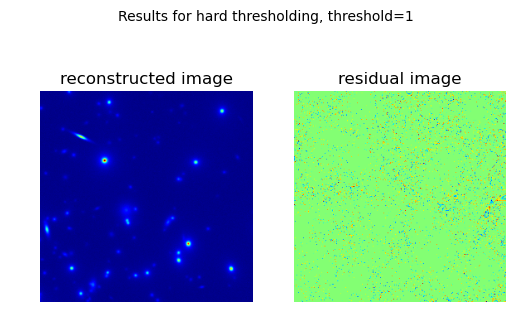

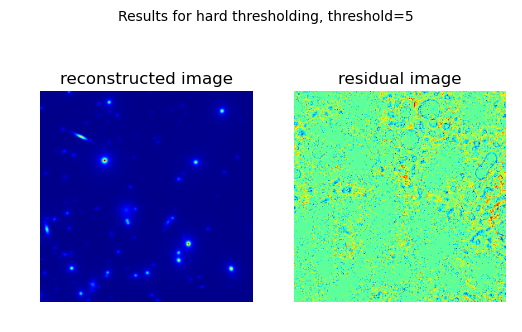

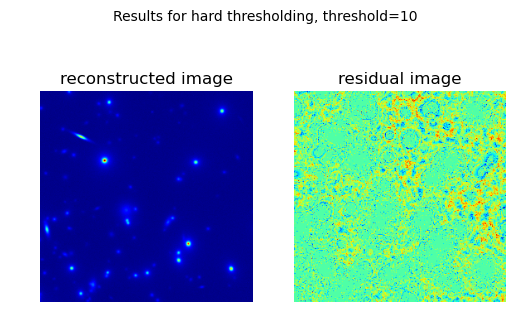

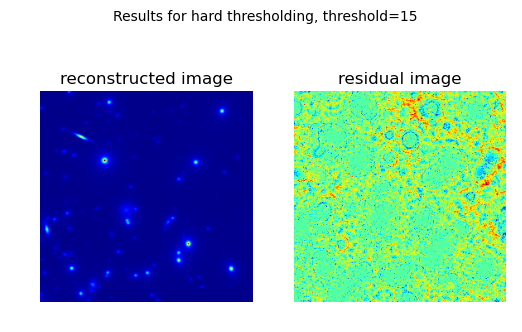

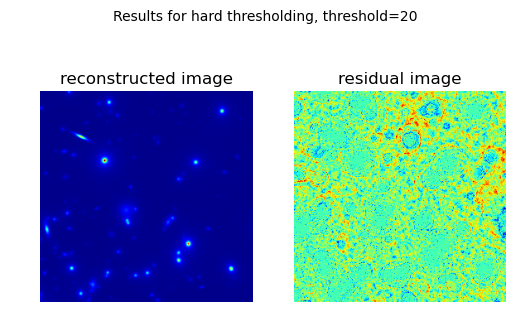

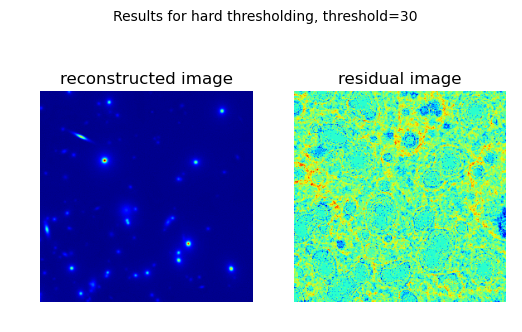

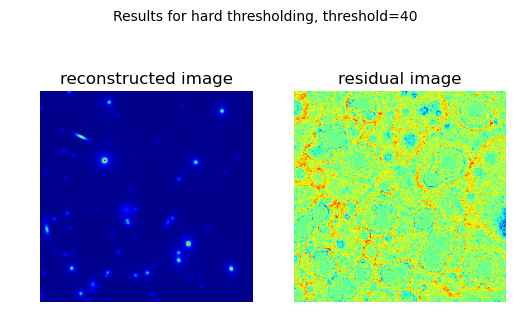

In [67]:
ht_error = []
nb_ht_coeff = []
for threshold in thresholds:
    ## Hard thresholding
    reconstruct, coeff_nb = reconstruct_image_thres(starlet_coeffs_noised,
                                             fin_noised,
                                             thresholding_func=hard_thresholding,
                                             threshold=threshold)
    # Store results
    ht_error.append(normalized_reconstruc_error(initial_im, reconstruct))
    nb_ht_coeff.append(coeff_nb)
    
    # Plot
    plot_reconstruct_results(initial_im, reconstruct,
                            method_name='hard thresholding',
                            method_condition = 'threshold',
                            threshold=threshold)
    

With hard thresholding, the more we increase the threshold, the more we can visually see that we remove information that is not purely noise from the original image. 

## Soft thresholding denoising

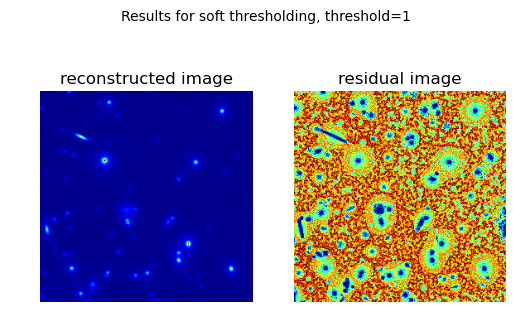

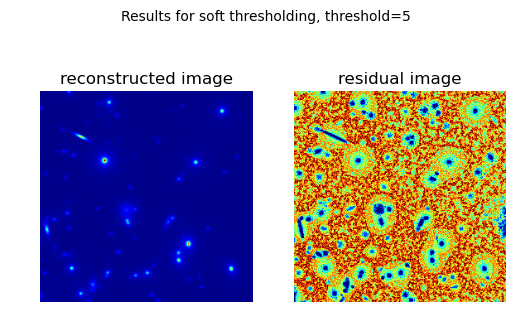

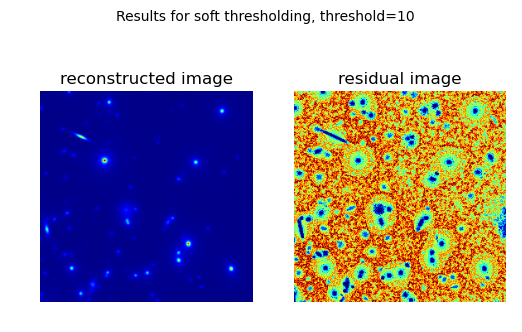

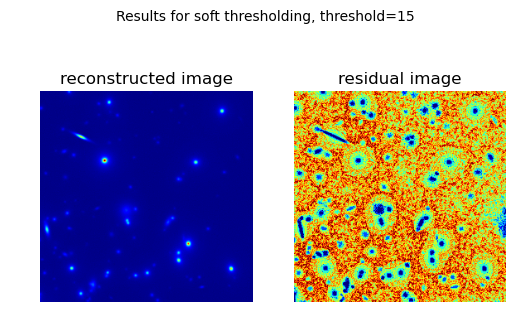

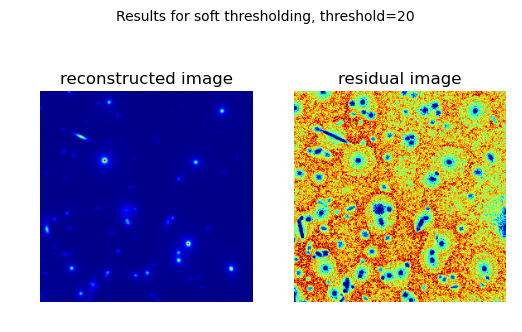

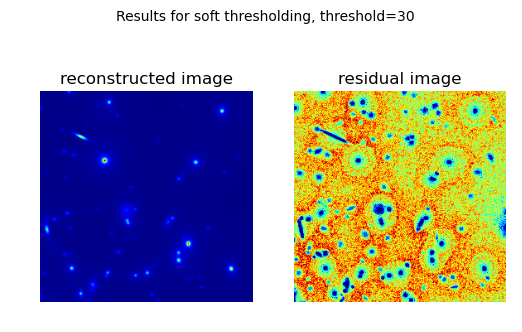

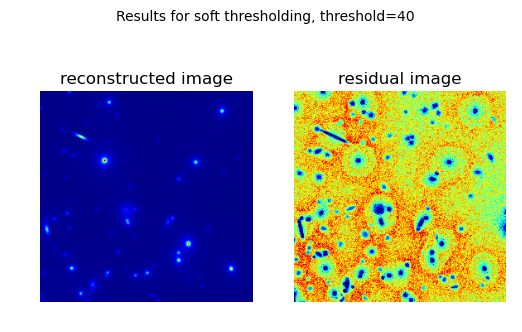

In [68]:
st_error = []
nb_st_coeff = []
for threshold in thresholds:
    
    ## Soft thresholding 
    reconstruct, coeff_nb = reconstruct_image_thres(starlet_coeffs_noised,
                                             fin_noised,
                                             thresholding_func=soft_thresholding,
                                             threshold=threshold)
    
    # Store results
    st_error.append(normalized_reconstruc_error(initial_im, reconstruct))
    nb_st_coeff.append(coeff_nb)
    
    # Plot
    plot_reconstruct_results(initial_im, reconstruct,
                            method_name='soft thresholding',
                            method_condition = 'threshold',
                            threshold=threshold)

With soft denoising we can see that the whole image is affected by the removal of the coefficients, this is due to the fact that all the coefficients are reduced with soft thresholding.


Looking at the residual image, we can see that when the threshold decreases, for both the hard and the soft thresholding, the quality of the reconstructed image increases both visually and numerically. 

## Multi-resolution denoising

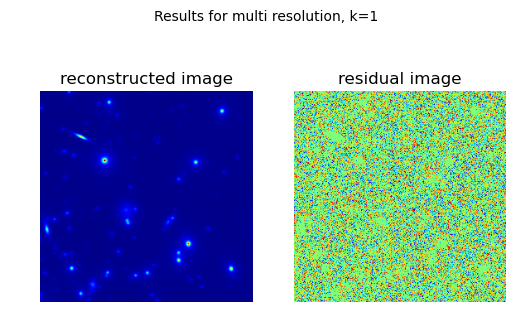

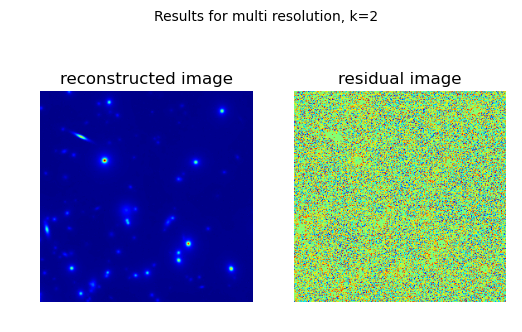

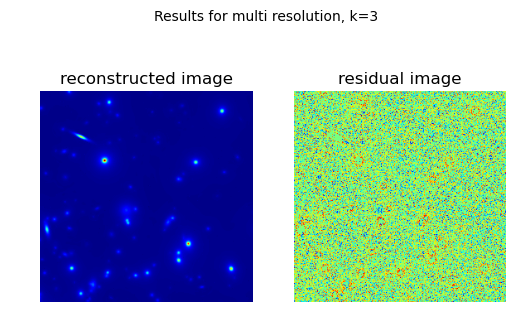

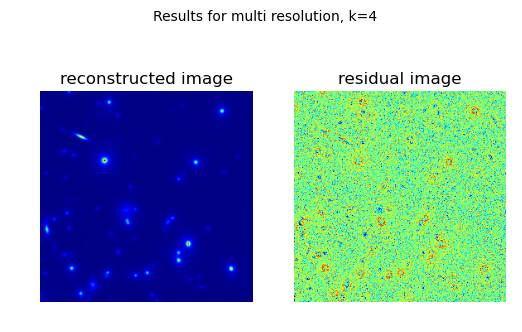

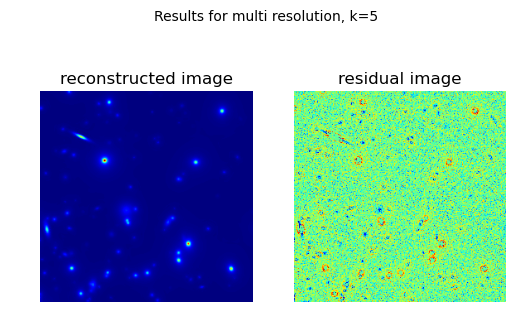

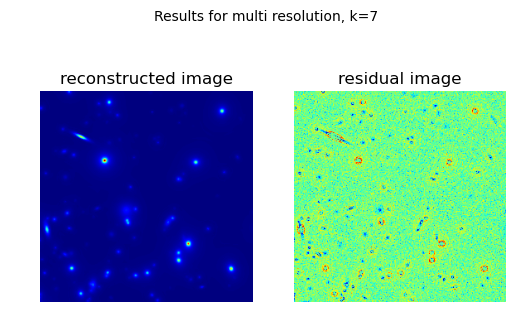

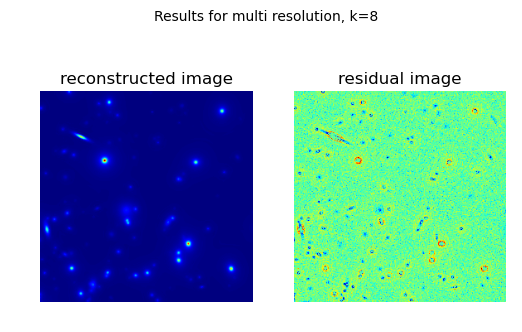

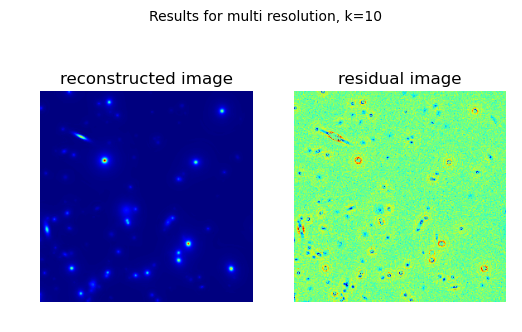

In [69]:
k_coeffs = [1, 2, 3, 4, 5, 7, 8, 10]
multi_error = []
nb_multi_coeffs = []
for k in k_coeffs:
    k_thresholds = [k*stds for stds in estimated_stds]
    reconstruct, coeff_count = multires_reconstruc(starlet_coeffs_noised, fin_noised, k_thresholds)
    nb_multi_coeffs.append(coeff_count)
    multi_error.append(normalized_reconstruc_error(initial_im, reconstruct))
    plot_reconstruct_results(initial_im, reconstruct,
                            method_name='multi resolution',
                            method_condition = 'k',
                            threshold=k)

Visually we can see that when k=3 we capture a lot of noise in the residual image and not much of the signal, which is the targeted behaviour. The more we increase k, the less coefficients we remove. When k becomes large (k>=7) we see that we remove significant signals around the stars.

## Numerical comparison of the methods

Let's now compare the methods quantitatively. We will use a normalized error to compare the reconstructed image and the original, noiseless image.

### Soft and hard denoising

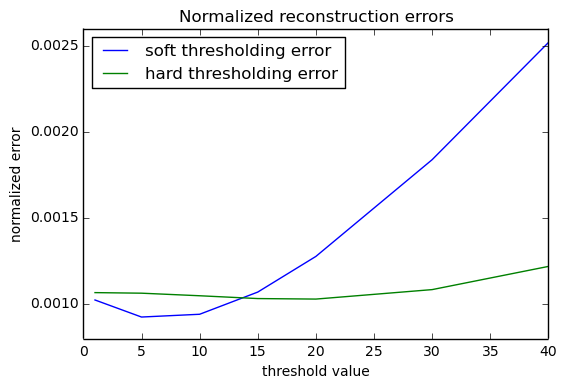

In [70]:
plt.plot(thresholds, st_error, label='soft thresholding error')
plt.plot(thresholds, ht_error, label='hard thresholding error')
plt.title('Normalized reconstruction errors')
plt.xlabel('threshold value')
plt.ylabel('normalized error')
plt.legend(loc=2)
plt.show()


We can see that at first increasing the threshold decreases the error, as more significant coefficients are taken into account. But if we keep increasing the threshold we end up start including coefficients that are produced by the noise, and therefore, the normalized error increases.

### Multi resolution denoising

Let's now look at a denoising technic based on various thresholds for each scale that are related to the level of noise in each wavelet scale.

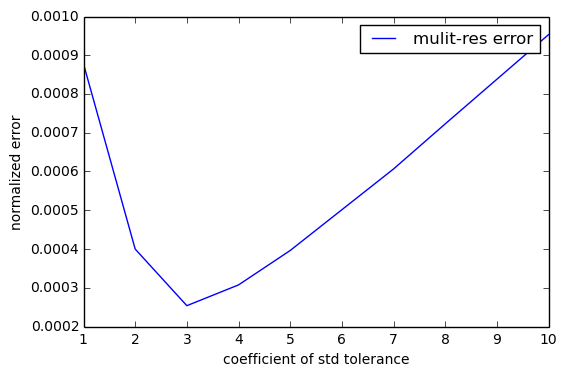

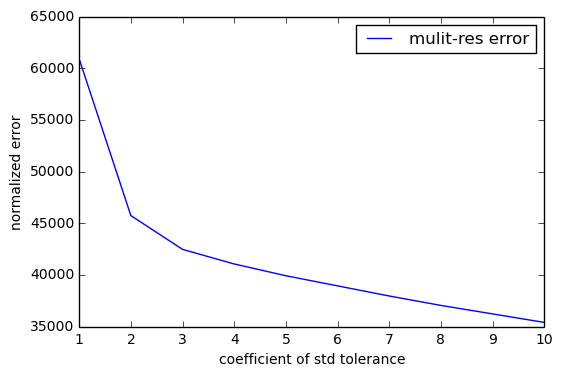

In [71]:
plt.plot(k_coeffs, multi_error, label='mulit-res error')
plt.xlabel('coefficient of std tolerance')
plt.ylabel('normalized error')
plt.legend()
plt.show()

plt.plot(k_coeffs, nb_multi_coeffs, label='mulit-res error')
plt.xlabel('coefficient of std tolerance')
plt.ylabel('normalized error')
plt.legend()
plt.show()

We observe that the multiresolution approach performs well and reaches a peak of performance for a k of 3.

As we are interested in sparsity, we are interested in finding a compromise between the number of coefficients we keep and the normalized error. To do this, let's visualize the normalized error as a function of the number of non-zero coefficients.

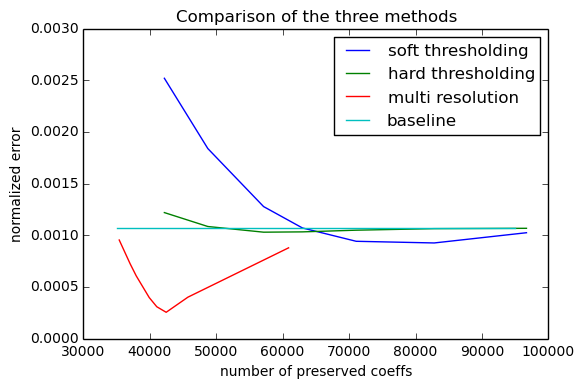

In [72]:
plt.plot(nb_st_coeff, st_error, label='soft thresholding')
plt.plot(nb_ht_coeff, ht_error, label='hard thresholding')
plt.plot(nb_multi_coeffs, multi_error, label='multi resolution')
baseline_error = normalized_reconstruc_error(initial_im,noised_image)
plt.plot(np.linspace(35000, 95000, 3), [baseline_error]*3, label = 'baseline')
plt.title('Comparison of the three methods')
plt.xlabel('number of preserved coeffs')
plt.ylabel('normalized error')
plt.legend(loc=1)
plt.show()

We can see that the multi resolution approach performs best, as it gives us a signigicantly lower error then the other methods at its peak of performance, which occurs for k=3. This method also provides more sparse solutions in the wavelet space. For k=3, 42.000 coefficients are necessary to obtain a normalized error of 0.00026.
For the soft thresholding approach, 83.000 coefficients are necessary to obtain a normalized error of 0.00093, which is therefore significantly worse then the first method.


# Deblurring with sparsity constraint in the starlet transform

/usr/local/lib/python3.4/dist-packages/pyfits/header.py:509: UserWarning: Header block contains null bytes instead of spaces for padding, and is not FITS-compliant. Nulls may be replaced with spaces upon writing.
  'Header block contains null bytes instead of spaces for '
/usr/local/lib/python3.4/dist-packages/pyfits/file.py:319: UserWarning: File may have been truncated: actual file length (265024) is smaller than the expected size (267840)
  (self.size, pos))


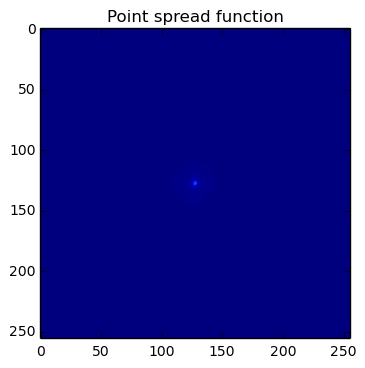

In [7]:
psf = pyfits.open('simu_psf.fits')[0].data
plt.imshow(psf)
plt.title('Point spread function')
plt.show()

In [8]:
conv_noised_im = signal.convolve2d(initial_im, psf, mode='same', boundary='symm') + noise_level*noise

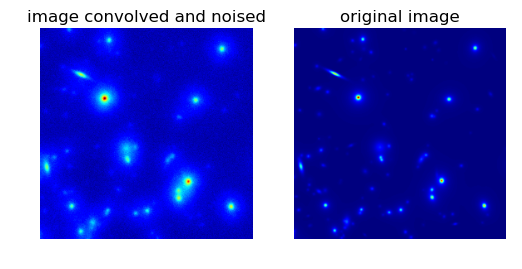

In [9]:
fig = plt.figure()
ax1 = fig.add_subplot(121)
ax1.imshow(conv_noised_im)
ax1.set_title('image convolved and noised')
ax1.axis('off') 
ax2 = fig.add_subplot(122)
ax2.imshow(initial_im)
ax2.axis('off')
ax2.set_title('original image')
plt.show()

Our goal is to retrieve the original image from the convolved and noised instance.

To achieve this we will implement a forward backward splitting algorithm.

In [10]:
def convolve(im, psf):
    im_ft = np.fft.fft2(im)
    psf_ft = np.fft.fft2(psf)
    convolved = np.fft.ifft2(im_ft*psf_ft)
    return np.real(np.fft.ifftshift(convolved))

def convolve_trans(im, psf):
    im_ft = np.fft.fft2(im)
    psf_ft = np.fft.fft2(psf).T
    deconvolved = np.fft.ifft2(im_ft*np.conj(psf_ft))
    return np.real(np.fft.ifftshift(deconvolved))


We want to minimize the sum of the data fidelity term and a weighted regularization term.

In this specific case we minimize the weighted sum of the l1 norm (sum of absolute values) of the starlet coefficients, and the square of euclidian distance between the initial convolved image and the transform of the estimated original image.



$$a^{\star} \in \text{argmin}_{\alpha} \: \frac{1}{2}\|y-H \Phi \alpha\|^2 + \lambda ||\alpha||_{l_1}$$

We can then retrieve the deconvolved image using $$x=\Phi*\alpha$$ 

To achieve this minimization we implement the iterative algorithm presented in the 4th class.

We observe that numerically the implemented algorithm allows us to iteratively minimize the sum of the two relevant terms, and that the algorithm seems to converge.


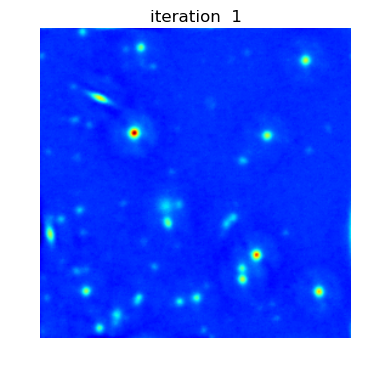

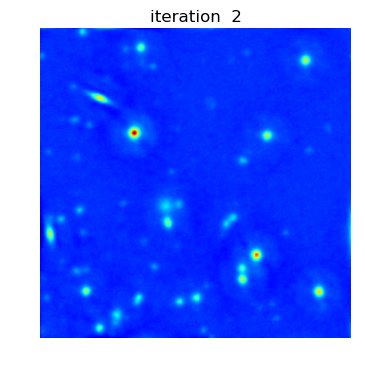

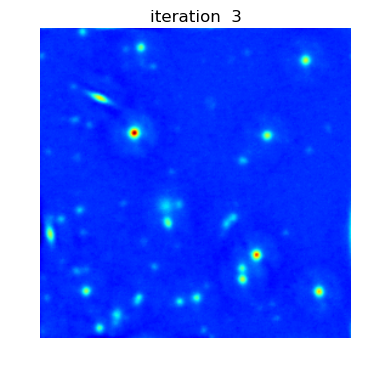

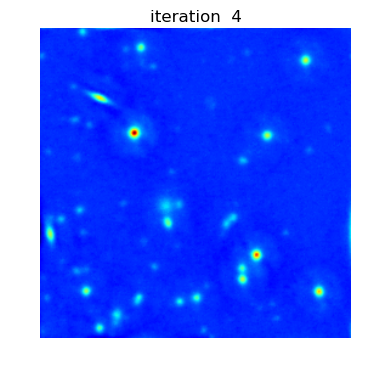

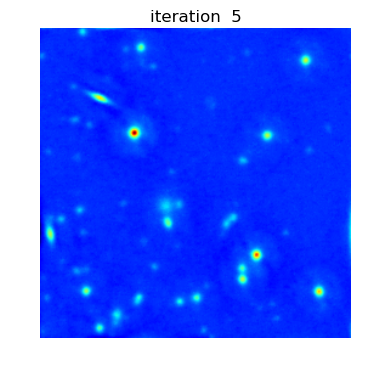

...

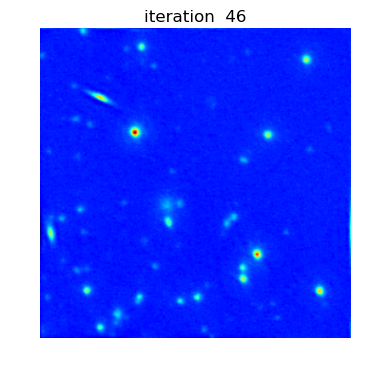

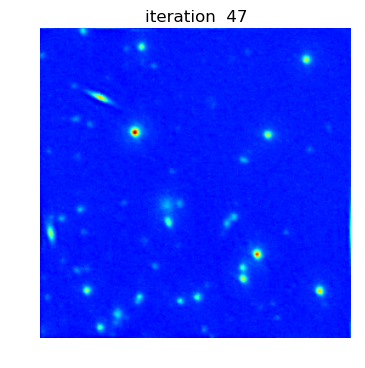

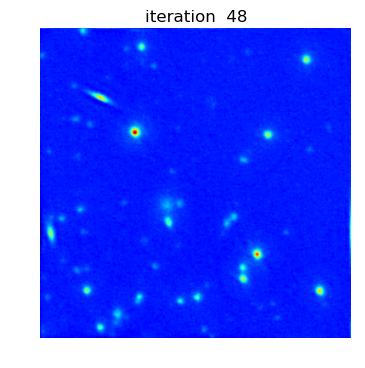

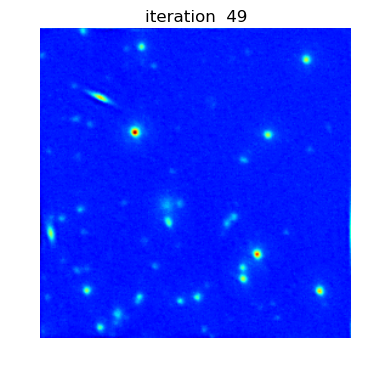

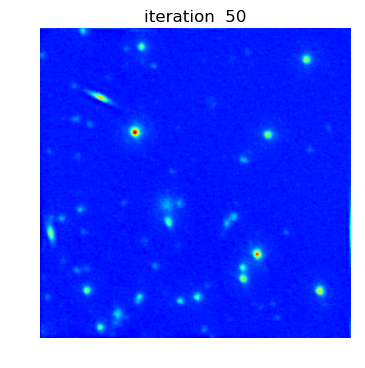

In [36]:
wavelet_nb = 3

# Initialize the coeffs with the starting point image
[starlet_coeffs_init, fin_init, mean_wav_init] = starlet_transform(np.zeros([256, 256]), wavelet_nb)

def compute_deconv_value(starlet_coeffs, final_starlet_coeffs, initial_image, psf, lambda_coeff):
    # The value we want to minimize with the iterative algorithm
    error = 0
    conved_im = convolve(reconstruct_image(starlet_coeffs, final_starlet_coeffs), psf)
    error += 1/2*l2_norm(initial_image - conved_im)
    error += lambda_coeff*(l1_norm(starlet_coeffs))
    return error


def deconv_step(starlet_coeffs, final_starlet_coeffs, psf, initial_image, step_size, wavelet_nb, lambda_coeff):
    conved_im = convolve(reconstruct_image(starlet_coeffs, final_starlet_coeffs), psf)
    convedt_im = convolve_trans(initial_image - conved_im, psf)
    [starlet_coeffs_step, fin_step, mean_wav_step] = starlet_transform(convedt_im, wavelet_nb)
    step_coeffs = step_size * starlet_coeffs_step + starlet_coeffs
    thres_coeffs = soft_thresholding(step_coeffs, step_size*lambda_coeff)
    return thres_coeffs
    

def deconv_algo(starlet_coeffs, final_starlet_coeffs, psf,
                initial_image, step_size, wavelet_nb,
                lambda_coeff, target_im, iter_nb=5, disp=False):
    target_error = []
    normal_error = []
    for i in range(iter_nb):
        starlet_coeffs = deconv_step(starlet_coeffs, final_starlet_coeffs,
                                     psf, initial_image, step_size,
                                     wavelet_nb, lambda_coeff)
        target_error.append(compute_deconv_value(starlet_coeffs, final_starlet_coeffs, initial_image, psf, lambda_coeff))
        deconved_im = reconstruct_image(starlet_coeffs, final_starlet_coeffs)
        normal_error.append(normalized_reconstruc_error(target_im, deconved_im))
        if(disp):
            plt.imshow(deconved_im)
            plt.axis('off')
            plt.title('iteration  {it_nb}'.format(it_nb=i + 1))
            plt.show()
    return starlet_coeffs, final_starlet_coeffs, target_error, normal_error
step_size = 1
lambda_coeff = 1
iterations = 50

deconv_coeffs, deconv_fin, deconv_error, im_deconv_error = deconv_algo(starlet_coeffs_init, fin_init, psf, conv_noised_im, step_size,
                                                                       wavelet_nb, lambda_coeff, initial_im, iterations, disp=True)


We observe that starting from  a black image, we manage to converge towards an image that indeed looks like a deconvolved version of the original image and that each iteration brings us closer to that goal.

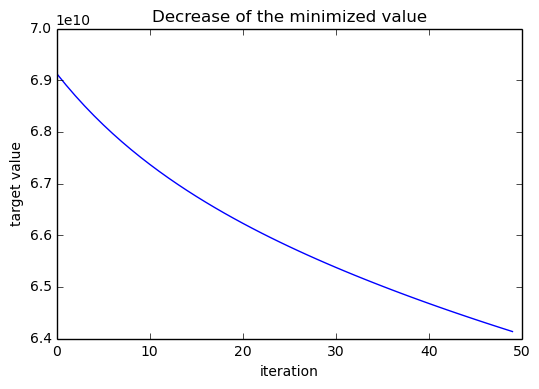

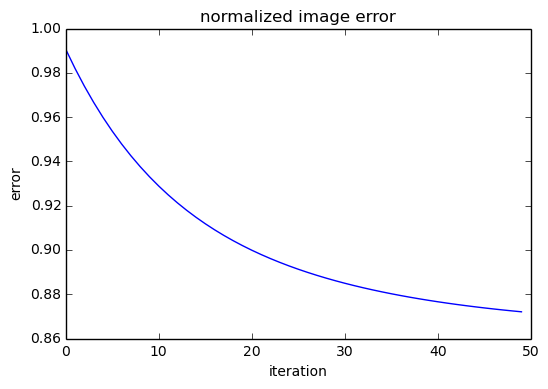

In [32]:
plt.plot(deconv_error)
plt.title('Decrease of the minimized value')
plt.xlabel('iteration')
plt.ylabel('target value')
plt.show()

plt.plot(im_deconv_error)
plt.title('normalized image error')
plt.xlabel('iteration')
plt.ylabel('error')
plt.show()

We observe that the sum we want to minimize decreases with each iteration, our implementation is therefore achieving the expected goal, which is to minimize the target value. 

We observe that this objective also achieves the goal of making the final image closer to the original one, before the deconvolution occured. This error remains nevertheless important. 

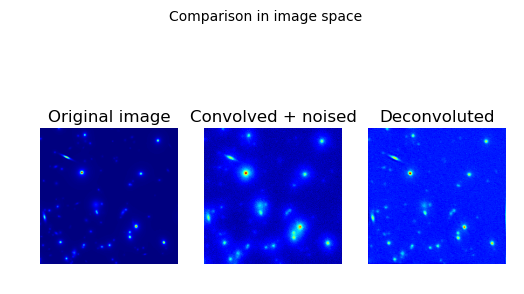

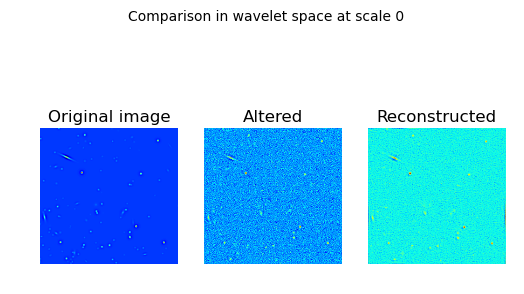

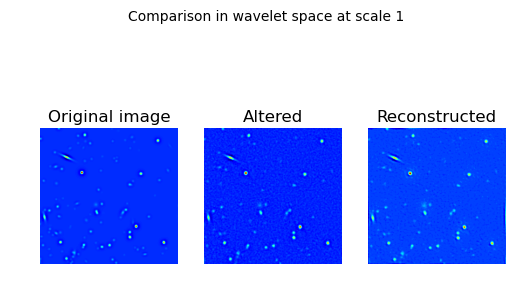

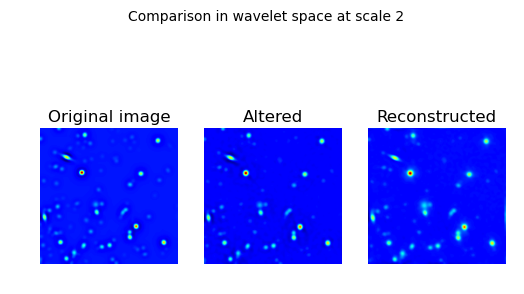

In [35]:
[starlet_coeffs_init, fin_init, mean_wav_init] = starlet_transform(conv_noised_im, wavelet_nb)

# Finest scale
fig = plt.figure()
ax1 = fig.add_subplot(131)
ax1.imshow(initial_im)
ax1.set_title('Original image')
ax1.axis('off') 
ax2 = fig.add_subplot(132)
ax2.imshow(conv_noised_im)
ax2.set_title('Convolved + noised')
ax2.axis('off') 
ax3 = fig.add_subplot(133)
ax3.imshow(reconstruct_image(deconv_coeffs, deconv_fin))
ax3.axis('off')
ax3.set_title('Deconvoluted')
fig.suptitle('Comparison in image space')
plt.show()

[starlet_coeffs_conv, starlet_fin_conv, conv_mean] = starlet_transform(conv_noised_im, wavelet_nb)

def plot_wavelet_comparison(starlet_coeffs_conv, deconv_coeffs, scale, cmap='jet'):
    # First wavelet scale
    fig = plt.figure()
    ax1 = fig.add_subplot(131)
    ax1.imshow(initial_coeffs[scale,], cmap=cmap)
    ax1.set_title('Original image')
    ax1.axis('off') 
    ax2 = fig.add_subplot(132)
    ax2.imshow(starlet_coeffs_conv[scale,], cmap=cmap)
    ax2.set_title('Altered')
    ax2.axis('off') 
    ax3 = fig.add_subplot(133)
    ax3.imshow(deconv_coeffs[scale,], cmap=cmap)
    ax3.axis('off')
    ax3.set_title('Reconstructed')
    fig.suptitle('Comparison in wavelet space at scale {scale}'.format(scale = scale))
    plt.show()

# Wavelet scales
for idx_scale in range(wavelet_nb):
    plot_wavelet_comparison(starlet_coeffs_conv, deconv_coeffs, idx_scale)

Visually, we see that the deconvolution is successfull to some extent. We retrieve sharper light sources compared with the altered original image, and those sources are indeed associated to stars present in the original image.

We see that we manage to remove a lot of noise present in the first wavelet scale, although some noise does remain. For larger scales, the global aspect remains overall similar.

Overall the algorithm produces good results in the joint deconvolution and denoising task.

# Inpainting 

To start we have to define a function that applies a given binary mask on our image.

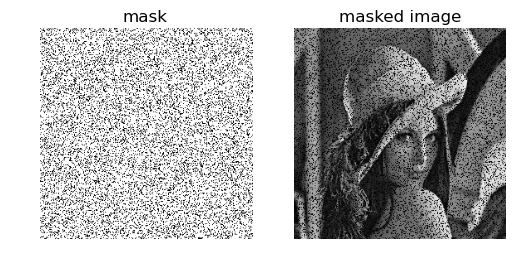

In [37]:
fraction = 0.8 # percentage of kept pixels
def create_mask(fraction, mask_size):
    mask = np.zeros([mask_size, mask_size])
    sel = np.random.permutation(mask_size**2)
    np.ravel(mask)[sel[np.arange(int(fraction*mask_size**2))]] = 1
    return mask

def apply_mask(im, mask):
    return im*mask

lena = np.asarray(Image.open('lena.jpg'))
mask = create_mask(fraction, 256)
masked_im = apply_mask(lena, mask) 
fig = plt.figure()
ax1 = fig.add_subplot(121)
ax1.imshow(mask, cmap='gray')
ax1.set_title('mask')
ax1.axis('off') 
ax2 = fig.add_subplot(122)
ax2.imshow(masked_im, cmap='gray')
ax2.axis('off')
ax2.set_title('masked image')
plt.show()

This time, we focus on inpainting and we therefore want to minimize


$$a^{\star} \in \text{argmin}_{\alpha} \: \frac{1}{2}\|y-M \Phi \alpha\|^2 + \lambda ||\alpha||_{l_1}$$

The major difference compared with the deconvolution is that in place of the convolution operator **H** we now have a masking operator **M** that puts to zero a number of pixel values.

As the regularization term is a l1 norm, the proximal operator is the soft threshling with a threshold that is equal to the regularization factor.

An iteration step therefore takes the following form :

$$\alpha^{t+1} = prox_{\gamma * f} (\alpha^{t} + \gamma \Phi^T(b - M \Phi \alpha^t))$$

Here as we work with the starlet transform \Phi is the starlet reconstruction function from starlet coefficients and \Phi^T is the starlet transform.

Such a step is implemented for the starlet transform in the function proximal_step.

In [41]:
wavelet_nb = 3
[starlet_coeffs_masked, fin_masked, mean_wav_masked] = starlet_transform(masked_im, wavelet_nb)
[starlet_coeffs_init, fin_init, mean_wav_init] = starlet_transform(np.zeros([256, 256]), wavelet_nb)

0.0


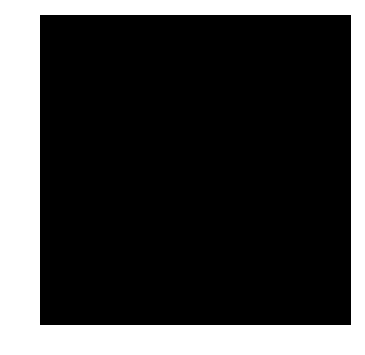

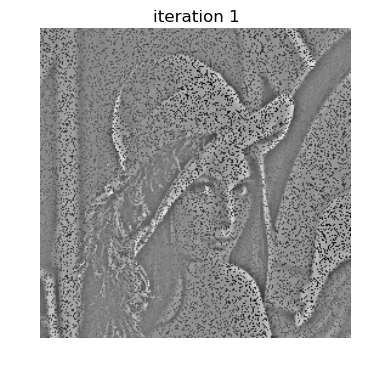

80.0349296331


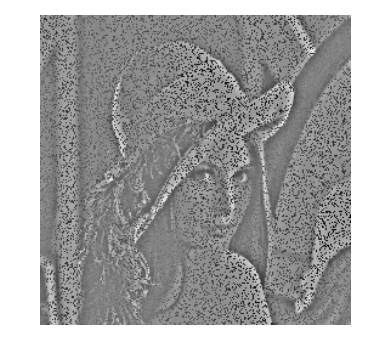

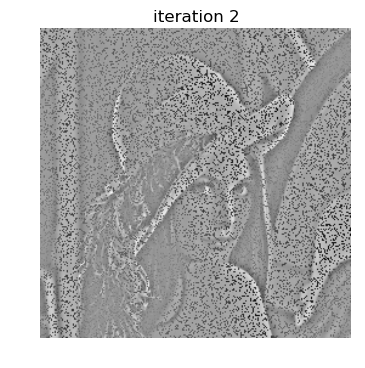

121.113371134


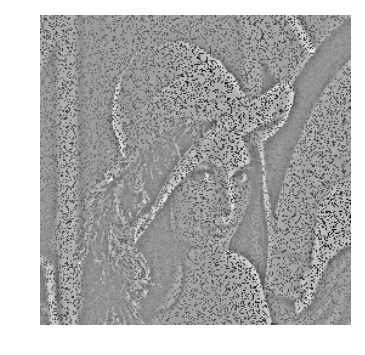

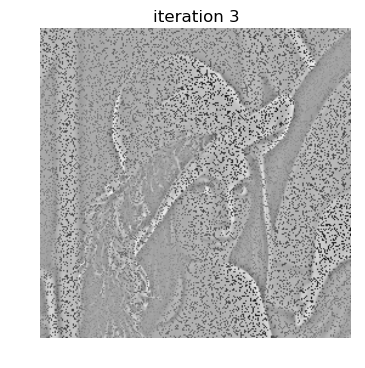

143.918663744


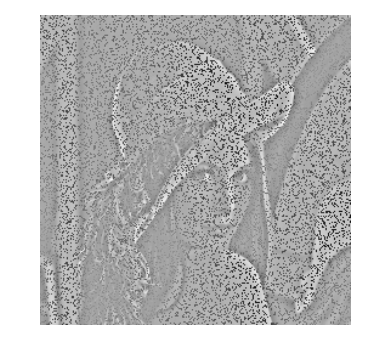

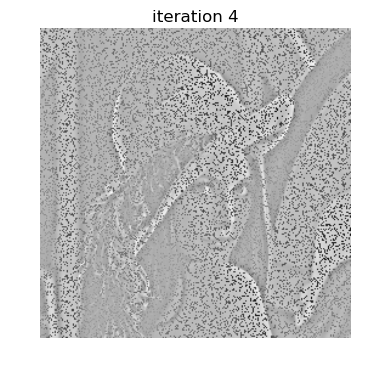

157.708714542


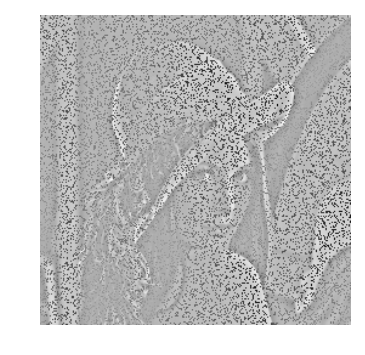

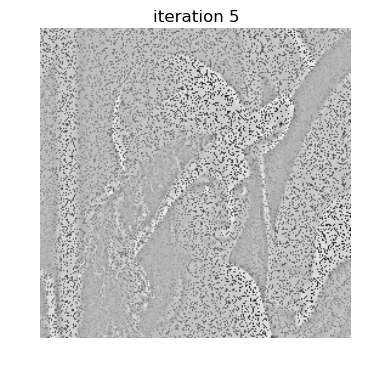

166.893269394


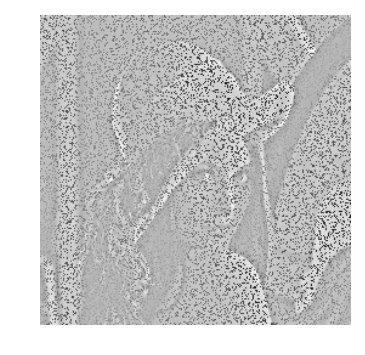

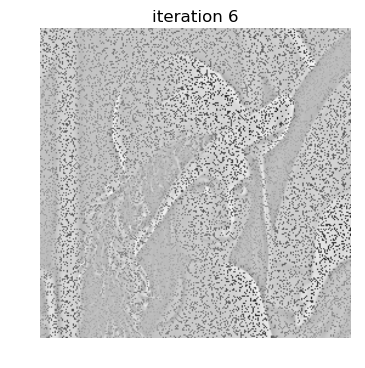

173.612825132


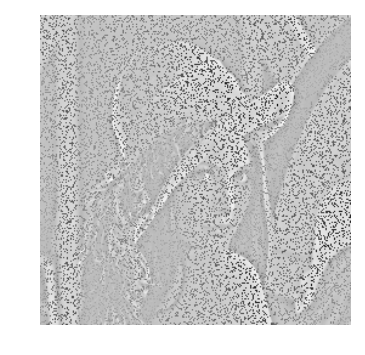

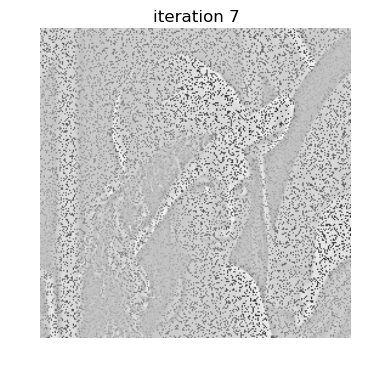

178.935728246


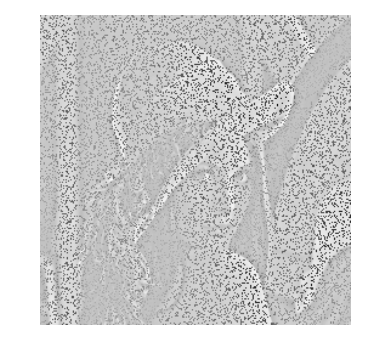

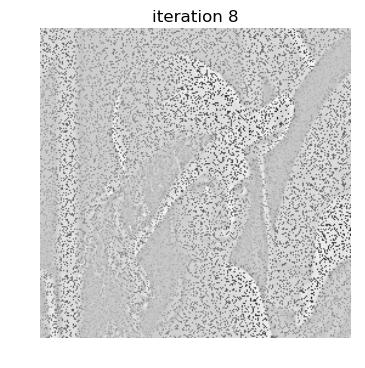

183.398412376


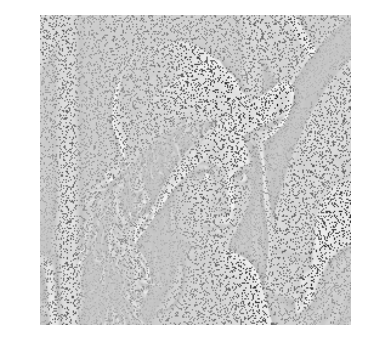

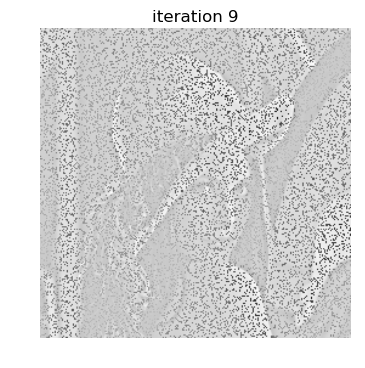

187.272992517


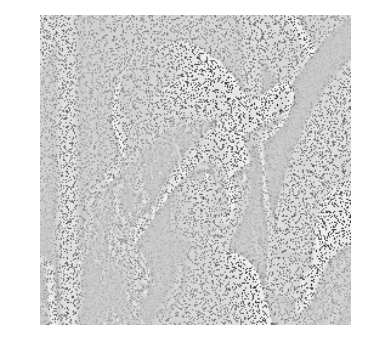

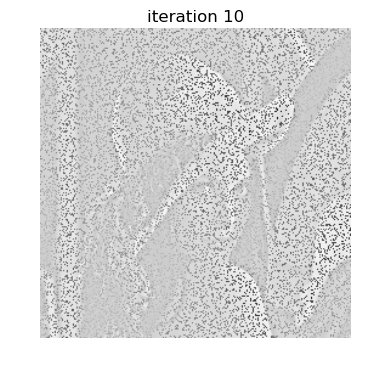

190.723382828


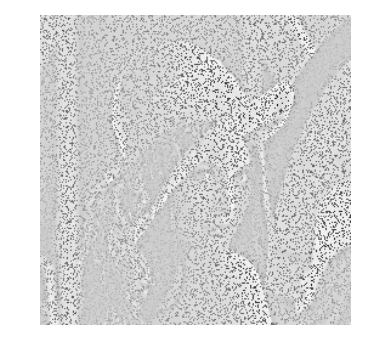

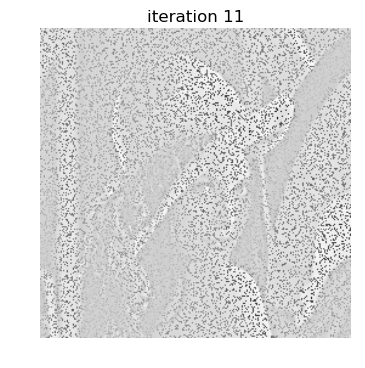

193.840576436


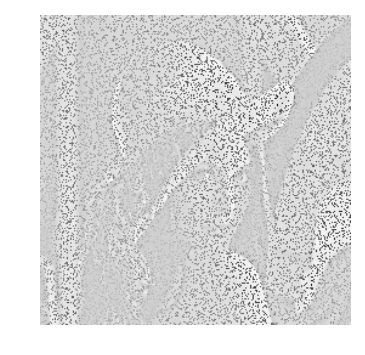

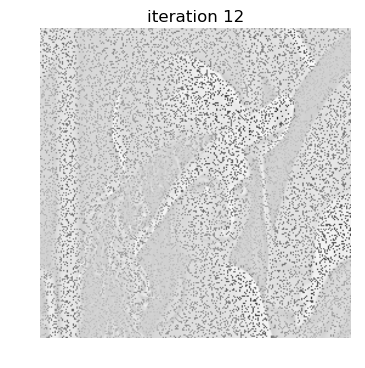

196.681178492


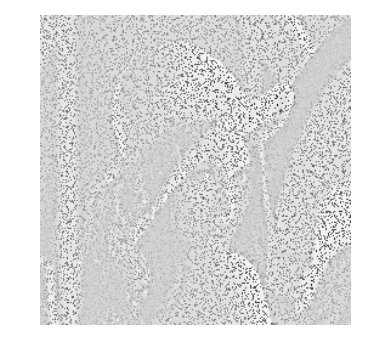

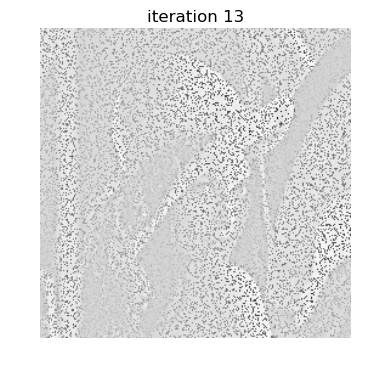

199.282205826


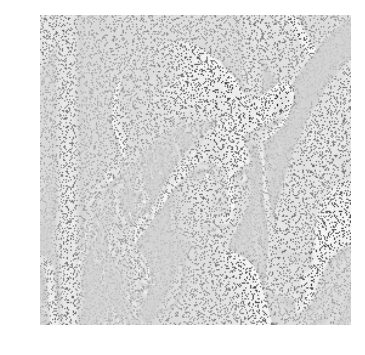

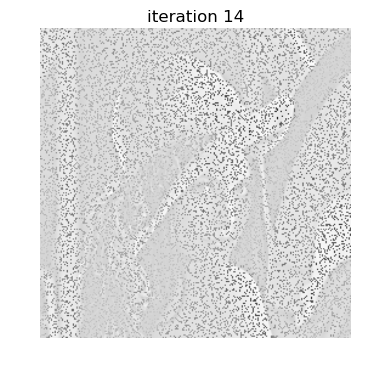

201.733533205


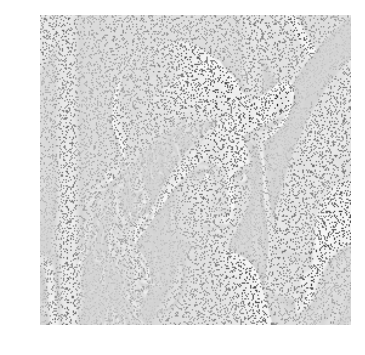

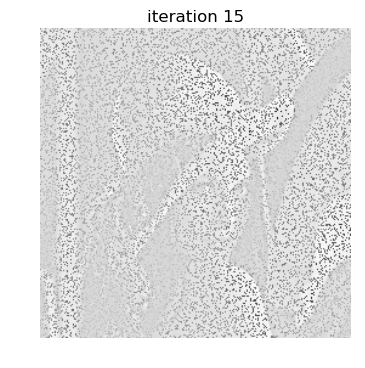

204.742115907


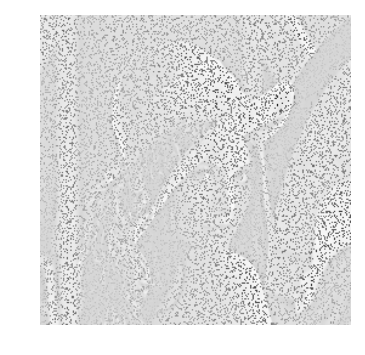

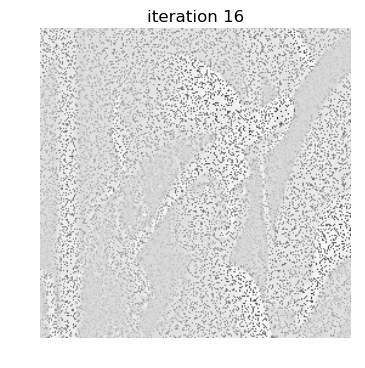

207.443132859


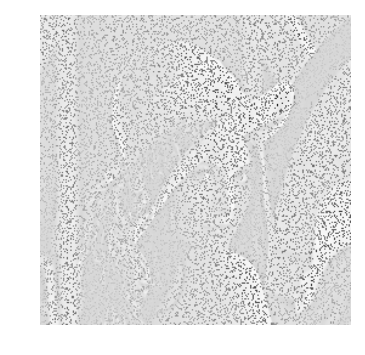

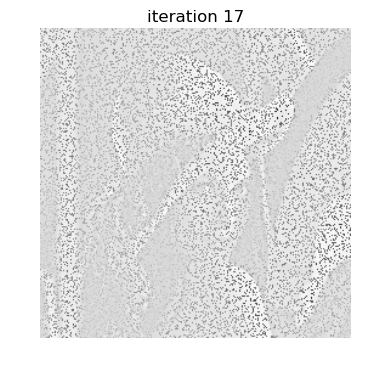

209.871001706


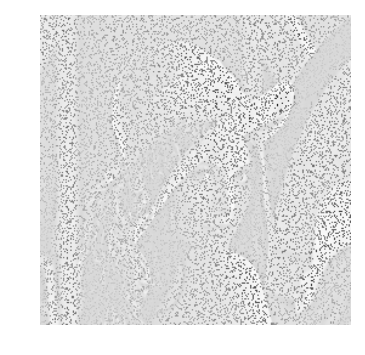

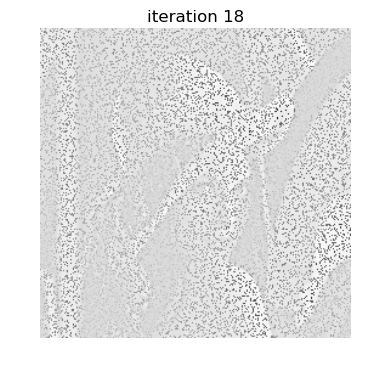

212.056455488


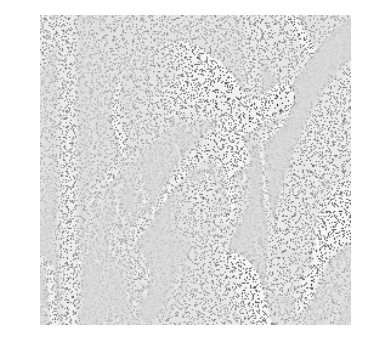

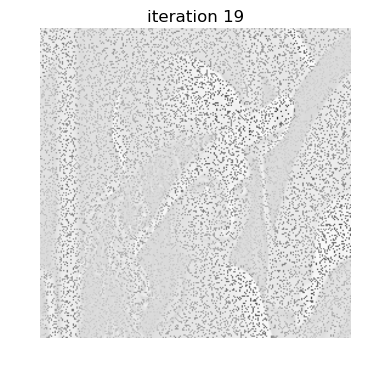

214.023724497


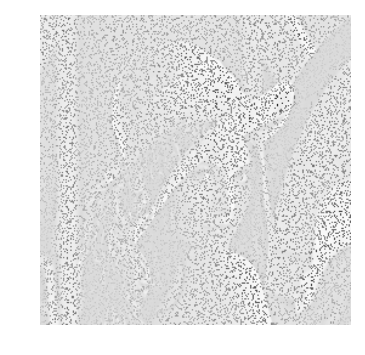

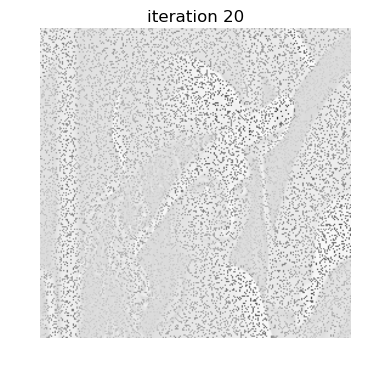

In [93]:
def compute_target_value(starlet_coeffs, final_starlet_coeffs, initial_image,
                          mask, lambda_coeff):
    error = 0
    masked_im = apply_mask(reconstruct_image(starlet_coeffs, final_starlet_coeffs), mask)
    error += 1/2*l2_norm(initial_image - masked_im)
    error += lambda_coeff*(l1_norm(starlet_coeffs))
    return error


def inpainting_step(starlet_coeffs, final_starlet_coeffs, initial_image,
                          mask, step_size, wavelet_nb, lambda_coeff, disp=True):
    starlet_coeffs = np.copy(starlet_coeffs)
    reconstruct_im = reconstruct_image(starlet_coeffs, final_starlet_coeffs)
    masked_im = apply_mask(reconstruct_im, mask)
    print(np.max(masked_im))
#     # gradient step in wavelet space
#     [starlet_coeffs_step, fin_step, mean_wav_step] = starlet_transform(initial_image - masked_im, wavelet_nb)
#     step_coeffs = step_size * starlet_coeffs_step + starlet_coeffs
#     thres_coeffs = soft_thresholding(step_coeffs, step_size*lambda_coeff)
#     # end gradient step in wavelet space

    # gradient step on im
    new_im = reconstruct_im + step_size * (initial_image - masked_im)
    [new_starlet_coeffs, fin_new, mean_wav_new] = starlet_transform(new_im, wavelet_nb)
    thres_coeffs = soft_thresholding(new_starlet_coeffs, step_size*lambda_coeff)
    # end gradient step on im
    plt.imshow(reconstruct_image(starlet_coeffs, final_starlet_coeffs), cmap='gray')
    plt.axis('off')
    plt.show()    
    return thres_coeffs


def inpainting_algo(starlet_coeffs, final_starlet_coeffs, initial_image,
                          mask, step_size, wavelet_nb, lambda_coeff, iter_nb=5, disp=False):
    error = []
    for i in range(iter_nb):
        starlet_coeffs = inpainting_step(starlet_coeffs, final_starlet_coeffs, initial_image,
                                                                   mask, step_size, wavelet_nb, lambda_coeff)
        error.append(compute_target_value(starlet_coeffs, final_starlet_coeffs, initial_image, mask, lambda_coeff))
        if(disp):
            inpainted_image = reconstruct_image(starlet_coeffs, final_starlet_coeffs)
            plt.title('iteration {it_nb}'.format(it_nb=i + 1))
            plt.imshow(inpainted_image, cmap='gray')
            plt.axis('off')
            plt.show()
    return starlet_coeffs, final_starlet_coeffs, error

lambda_coeff = 1
step_size = 0.5
iterations = 20
thres_coeffs, thres_fin, prox_errors = inpainting_algo(starlet_coeffs_init, fin_init, masked_im,
                                                mask, step_size, wavelet_nb, lambda_coeff, iterations, disp=True)
inpainted_im = reconstruct_image(thres_coeffs, thres_fin)


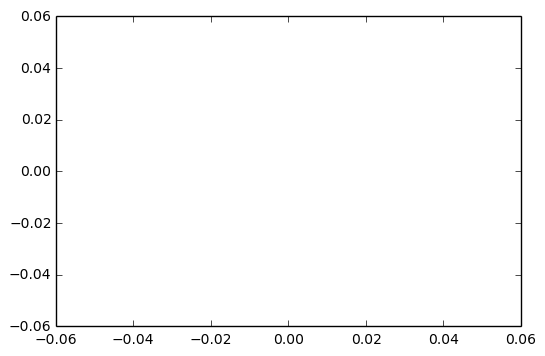

In [75]:
plt.plot(prox_errors)
plt.show()

Unfortunately, this code doesn't produce the expected inpainting results.
I tried both doing the gradient step in the pixel and wavelet space, and both variants produce the same results.
For some reason I haven't been able to find, my pixel values get strongly negative.
Despite several debugging attemps I have not yet found what the problem is, and how come the target value decreases as expected while the image does not get effectively inpainted.

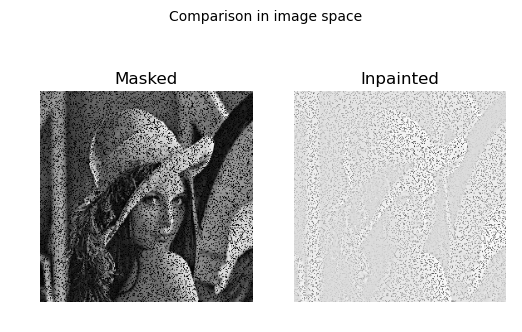

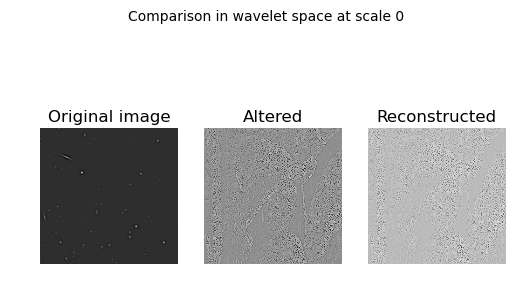

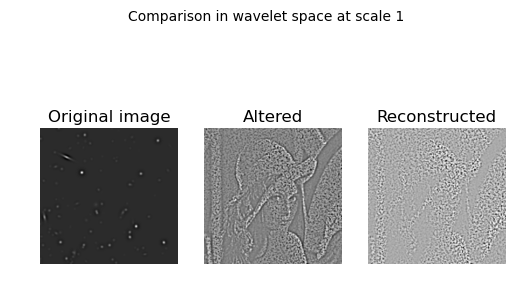

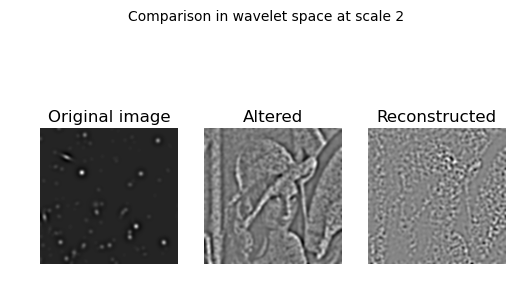

In [76]:
# Finest scale
fig = plt.figure()
ax2 = fig.add_subplot(121)
ax2.imshow(masked_im, cmap='gray')
ax2.set_title('Masked')
ax2.axis('off') 
ax3 = fig.add_subplot(122)
ax3.imshow(inpainted_im, cmap='gray')
ax3.axis('off')
ax3.set_title('Inpainted')
fig.suptitle('Comparison in image space')
plt.show()

# Wavelet scales
for idx_scale in range(wavelet_nb):
    plot_wavelet_comparison(starlet_coeffs_masked, thres_coeffs, idx_scale, cmap='gray')

We see that the inpainting operates by removing non-significant coefficients at all scales. 
This allows for a smoothing of the pixel coefficients in the image space that achieves an inpainting.

We can see looking at the reconstructed image that the inpainting is more or less successfull depending on the regions of the image.

# Old results from previous inpainting attempts

Below I display some results I obtained that also did a poor inpainting job.
This results were obtained with a previous version of the code before I tried debugging it on lena (although lena's image is less appropriate to the starlet transform, it has the advantage of having a wider dynamic range)

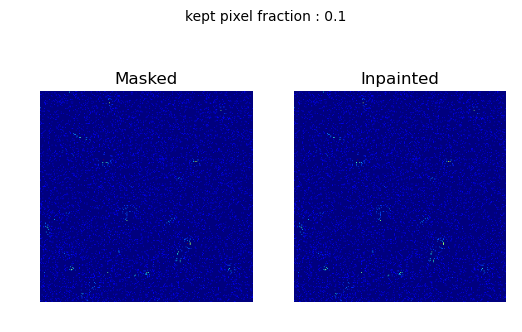

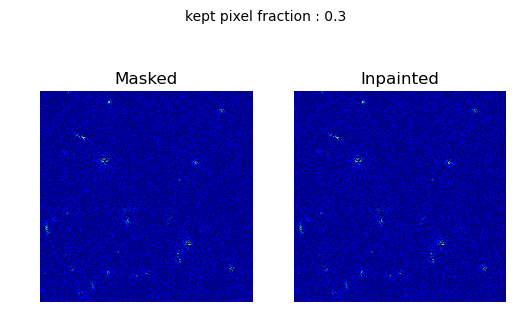

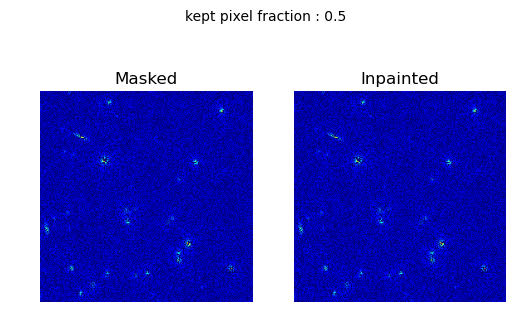

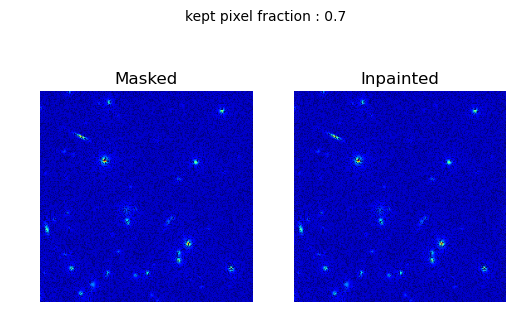

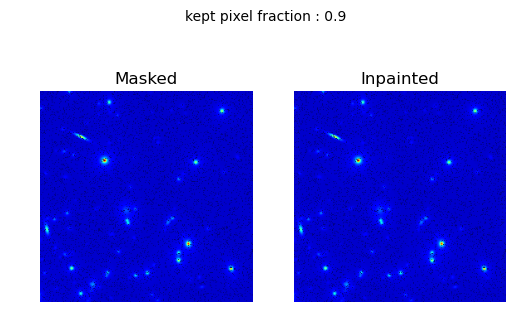

In [106]:
lambda_coeff = 1
step_size = 0.5
iterations = 20

fractions = [0.1, 0.3, 0.5, 0.7, 0.9]
for fraction in fractions:
    mask = create_mask(fraction, 256)
    masked_im = apply_mask(initial_im, mask)
    [starlet_coeffs_masked, fin_masked, mean_wav_masked] = starlet_transform(masked_im, wavelet_nb)
    thres_coeffs, thres_fin, prox_errors = inpainting_algo(starlet_coeffs_masked, fin_masked, masked_im,
                                                                 mask, step_size, wavelet_nb,
                                                                 lambda_coeff, iterations)
    inpainted_im = reconstruct_image(thres_coeffs, thres_fin)
    fig = plt.figure()
    ax1 = fig.add_subplot(121)
    ax1.imshow(masked_im)
    ax1.set_title('Masked')
    ax1.axis('off') 
    ax2 = fig.add_subplot(122)
    ax2.imshow(inpainted_im)
    ax2.set_title('Inpainted')
    ax2.axis('off') 
    fig.suptitle('kept pixel fraction : {frac}'.format(frac=fraction))
    plt.show()


Overall we observe that the performance is degraded when a large fraction of the pixels is masked, which was expected.

We can see that for small fractions of removed images, the inpainting algorithm manages to fill almost all the missing values in the areas that are associated with stars.

For large fractions of removes pixels (first images) the results are pretty poor as the algorithm does not manage to reconstruct the stars.


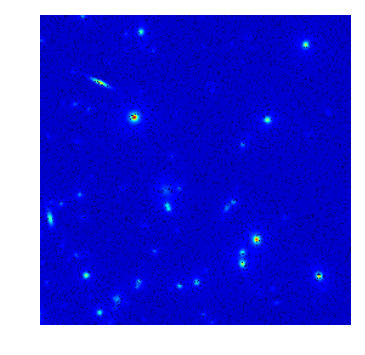

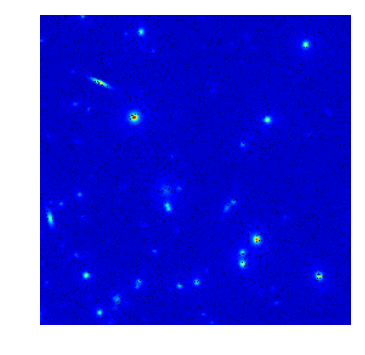

In [107]:
plt.imshow(masked_im)
plt.axis('off') 
plt.show()
plt.imshow(inpainted_im )
plt.axis('off') 
plt.show()
